In [1]:
import numpy as np
import os, sys
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
import pandas as pd
from cellpose import utils, io, models, plot
from scipy.spatial import distance as dist
import re
import tools
from radfil import radfil_class, styles
from astropy import units as u
import imageio.v2 as imageio
import copy
from PIL import Image
from fil_finder import FilFinder2D
from shapely.geometry import Polygon
from skimage.util import invert
from skimage.morphology import skeletonize
from cv2 import imwrite
from tools import prune2
from scipy.interpolate import splprep
from scipy.interpolate import splev
from IPython.core.display import HTML
from scipy.signal import argrelextrema
import random

date = "example_data"
my_data = "../data/" + date + "/Height/"
my_pfe = "../data/" + date + "/Peak_Force_Error/"
my_apm = "../data/" + date + "/Amplitude/"
my_sti = "../data/" + date + "/Stiffness/"
segments_path = "../cellpose_outputs/" + date + "/Height/"
cell_path = "Individual_cells/"
diam = 60
flow = 0.8

## Run Cellpose

In [2]:
# Load up a list of input files from our example data.
files = os.listdir(my_data)
for fichier in files[:]:
    if not(fichier.endswith(".png")):
        files.remove(fichier)
        
# Sort files by timepoint.
files.sort(key = tools.natural_keys)      

# Create a list that contains the full path to each of our image files. 
save_names = [segments_path + file for file in files]
file_names = [my_data + file for file in files]

## Not necessary, so long as diameter and flow threshold are known

In [14]:
# Specify that the cytoplasm Cellpose model for the segmentation. 
model = models.Cellpose(gpu=True, model_type='cyto')

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
channels = [0,0]

# Loop over all of our image files and run Cellpose on each of them. 
for filename, savename in zip(file_names, save_names):
    img = io.imread(filename)
    masks, flows, styles,diams = model.eval(img, diameter = diam, channels=channels, flow_threshold = flow,min_size=800)

    # save results so you can load in gui
    io.masks_flows_to_seg(img, masks, flows, diams, savename, channels)

    #save results as png
    io.save_to_png(img, masks, flows, savename)

In [4]:
# Get the filenames for our segmentation datasets. 
segmented = os.listdir(segments_path)
for fichier in segmented[:]: 
    if not(fichier.endswith(".npy")):
        segmented.remove(fichier)

# Sort the filenames by timepoint. 
segmented.sort(key = tools.natural_keys)

# Create a list that records the timepoints for every image. 
time_list = []
for segment in segmented:
    time_list.append(int(re.findall(r'\d+', segment)[0]))

In [5]:
def remove_large_masks(array,max_size=-1):
    ''' Removes all masks above a certain area threshold. Can be turned off by setting to -1'''
    if max_size==-1:
        return array
    else:
        unique,counts = np.unique(array,return_counts=True)
        area_dict=dict(zip(unique,counts))
        for ID in area_dict:
            if area_dict[ID]>max_size:
                array = array - ((array==ID)*ID)
        return array

In [6]:
# Initialize lists.
outl_temp = []
height_img_list = []
stiff_img_list = []
pfe_img_list = []
areal_unfiltered = []
areal_filtered = []

# Fill lists with img and outline data from each segment
for segment, time in zip(segmented, time_list):
    # Load up the segmentation data. 
    dat = np.load(segments_path + segment, allow_pickle=True).item()
    if len(dat['masks'])!=0:
        unique,counts=np.unique(dat['masks'],return_counts=True)
        areal_unfiltered= areal_unfiltered + list(counts[1:])
    # Remove small masks from the data
    dat["masks"] = utils.fill_holes_and_remove_small_masks(dat["masks"], min_size = 800)
    dat['masks'] = remove_large_masks(dat['masks'],max_size=-1)
    if len(dat['masks'])!=0:
        unique,counts=np.unique(dat['masks'],return_counts=True)
        areal_filtered = areal_filtered + list(counts[1:])
    # Populate list with each cell outline.
    outl = utils.outlines_list(dat['masks'])
    outl_temp.append(outl)
    
    # Populate list with each original image.
    image = dat["img"]
    height_img_list.append(image)
    
    # If it exists, read in the png with the stiffness and PFE.
    if os.path.exists(my_sti + str(time) + "_Stiffness.png") == True:
        stiff_img_list.append(imageio.imread(my_sti + str(time) + "_Stiffness.png"))
    else:
        stiff_img_list.append(np.nan)
        
    if os.path.exists(my_pfe + str(time) + "_PFE.png") == True:
        pfe_img_list.append(imageio.imread(my_pfe + str(time) + "_PFE.png"))
    else:
        pfe_img_list.append(np.nan)

In [7]:
# The image dictionary contains the complete images for all of the image types. 
img_dict = {
    "Height": height_img_list,
    "Stiffness": stiff_img_list,
    "PFE": pfe_img_list
    }
# The metadata dictionary will hold all of the data we want to save into our final table.
metadata_dict = {}

# The individual cell dictionary will save information for each individual cell such as the outline, skeleton, cropped image, etc. 
ind_cell_dict = {}

# The structural dictionary will hold information on the timepoint of each image, the cell IDs for each cell in each image,
# and the outlines and bounding boxes for each cell in each image.
structural_dict = {
    "Time": time_list
    }

In [8]:
# Initialize a list of boxes
boxes_temp = []
box_img = copy.deepcopy(height_img_list)

# Fill lists with the coordinates of bounding boxes for each cell outline.
for outl, img in zip(outl_temp, box_img):
    boxes = tools.get_boxes(outl)
    boxes_temp.append(boxes)
    for box in boxes:
        (startX, startY, endX, endY) = box.astype("int")
        cv2.drawContours(img, [box.astype("int")], -1, (0, 255, 0), 2)

In [9]:
# initialize our centroid tracker and frame dimensions
ct = tools.CentroidTracker()
(H, W) = (None, None)

# Initialize a new set of lists that will contain lists of IDs, outlines, and centers for each image file. 
IDs_list = []
outl_list = []
boxes_list = []
centers_list = []

# loop over the outlines and boxes for each file.
for boxes, img, outls in zip(boxes_temp, box_img, outl_temp):
    # update our centroid tracker using the computed set of bounding box rectangles
    if len(outls)!=0:
        objects = ct.update(boxes, outls)
    # Initialize a new set of lists
    IDs = []
    outl_new = []
    boxes_new = []
    centers = []
    # loop over the tracked objects
    if len(outls)!=0:
        for (objectID, info) in objects.items():
            # draw both the ID of the object and the centroid of the
            # object on the output frame
            text = "ID {}".format(objectID)
            cv2.putText(img, text, (info[1][0] - 10, info[1][1] - 10),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
            cv2.circle(img, (info[1][0], info[1][1]), 4, (0, 255, 0), -1)
            # append the object ID and its associated outline and center to the lists. 
            IDs.append(objectID)
            outl_new.append(info[2])
            centers.append(info[1])
            boxes_new.append(info[0])
    boxes_list.append(boxes_new)
    IDs_list.append(IDs)
    outl_list.append(outl_new)
    centers_list.append(centers)

In [10]:
# Add our new lists to the proper dictionaries. 
structural_dict["IDs"] = IDs_list
structural_dict["outlines"] = outl_list
structural_dict["bounding_boxes"] = boxes_list

metadata_dict["centroids"] = centers_list

# Destroy the temporary lists to get some more space. 
boxes_temp.clear()
outl_temp.clear()

In [11]:
ind_cell_dict = {}
ind_cell_dict["Height"], ind_cell_dict["Mask"] = tools.extract_ind_cells(IDs_list, outl_list, img_dict["Height"])

In [12]:
#list of skeletons (before and after branch pruning) with associated timepoints
unpruned_skel_list=[]
skel_list = []
#list of masks with skeletons overlayed in black
over_list=[]
#lists of poles, lengths, and centroids
pole_list = []
length_list = []
centroid_list = []
for time, mask_set in zip(structural_dict["Time"], ind_cell_dict["Mask"]):
    unpruned_skel_set = []
    skel_set = []
    over_set = []
    length_set = []
    pole_set = []
    centroid_set = []
    #create skeletons; save masks, skeletons, and masks with skeletons as lists, save skeletons and skeletons with masks as images
    for mask in mask_set:
        if len(mask.shape)>2:
            new_mask=mask[:,:,0]>0
        else:
            new_mask = mask>0
        print(time)
        unpruned_skel = tools.padskel(mask)
        outline = utils.masks_to_outlines(new_mask)
        long = np.shape(unpruned_skel)[0]<np.shape(unpruned_skel)[1]
        poles,centroid = tools.explore_poles(outline,long)
        skel,length,pts,s = tools.prune2(unpruned_skel,outline,new_mask,poles,sensitivity=5)
        over = invert(skel+invert(new_mask)) #the mask overlayed on the skeleton (boolean array)
        pole_set.append(poles)
        unpruned_skel_set.append(unpruned_skel)
        skel_set.append(skel)
        over_set.append(over)
        length_set.append(length)
    pole_list.append(pole_set)
    unpruned_skel_list.append(unpruned_skel_set)
    skel_list.append(skel_set)
    over_list.append(over_set)
    length_list.append(length_set)

3301940
3302004


/home/WereSalmon/AFM_Automation_code/tools.py:898: UserWarning: Sorting terminated early when points exceeded allowable distance
  warnings.warn('Sorting terminated early when points exceeded allowable distance')


3302013
3302022
3302032
3302040


/home/WereSalmon/AFM_Automation_code/tools.py:984: UserWarning: curvature threshold exceeded. additional pruning executed in response
  warnings.warn('curvature threshold exceeded. additional pruning executed in response')


3302137
3302137
3302146
3302146
3302155
3302155
3302213
3302213
3302221
3302221
3302230
3302230
3302239
3302239
3302248
3302248
3302258
3302258
3302325
3302325
3310009
3310009
3310036
3310036
3310053
3310053
3310111
3310111
3310120
3310120
3310138
3310138
3310138
3310147
3310147
3310147
3310147
3310156
3310156
3310156
3310205
3310205
3310205
3310214
3310214
3310214
3310223
3310223
3310223
3310240
3310240
3310249
3310249
3310249
3310316
3310316
3310316
3310325
3310325
3310325
3310334
3310334
3310334


/home/WereSalmon/AFM_Automation_code/tools.py:905: UserWarning: path did not reach destination
  warnings.warn('path did not reach destination')


3310343
3310343
3310343
3310351
3310351
3310351
3310400
3310400
3310400
3310409
3310409
3310409
3310436
3310436
3310436
3310445
3310445
3310445
3310454
3310454
3310454


In [15]:
# Adding to dictionaries. 
ind_cell_dict["Skeleton"], ind_cell_dict["Skel + Mask"], ind_cell_dict["Unpruned"] = skel_list, over_list, unpruned_skel_list
metadata_dict["Length"] = length_list
metadata_dict["Poles"] = pole_list

In [21]:
flattened_lengths = []
for length_set in metadata_dict['Length']:
    flattened_lengths = flattened_lengths+length_set

(array([ 2., 11., 18., 19., 13., 14., 11.,  0.,  1.,  1.]),
 array([ 72.66742533,  94.82340173, 116.97937812, 139.13535451,
        161.2913309 , 183.4473073 , 205.60328369, 227.75926008,
        249.91523648, 272.07121287, 294.22718926]),
 <BarContainer object of 10 artists>)

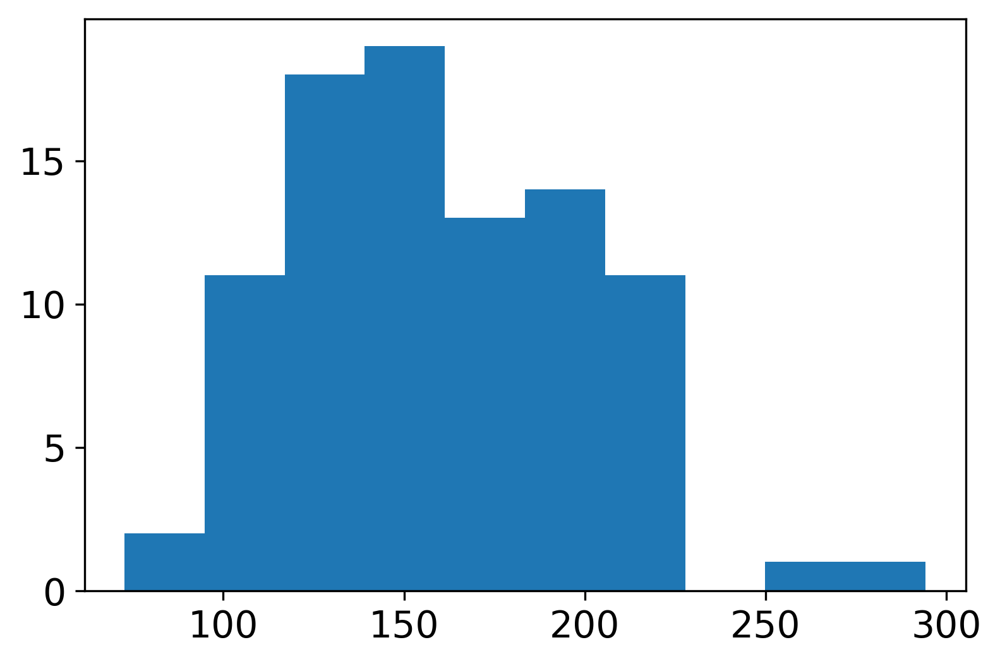

In [22]:
plt.hist(flattened_lengths)

/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:419: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig=plt.figure(figsize=(10,5))


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.
No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:105: UserWarning: `header` and `distance` will not be used; all calculations in pixel units.
  warnings.warn("`header` and `distance` will not be used; all calculations in pixel units.")
/home/WereSalmon/miniconda3/envs/cellpose/lib/python3.8/site-packages/radfil/radfil_class.py:156: UserWarning: Calculate in pixel scales.
  warnings.warn("Calculate in pixel scales.")


No binning is applied.


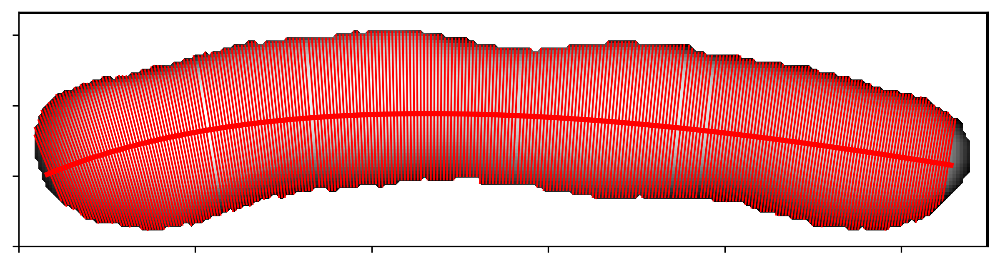

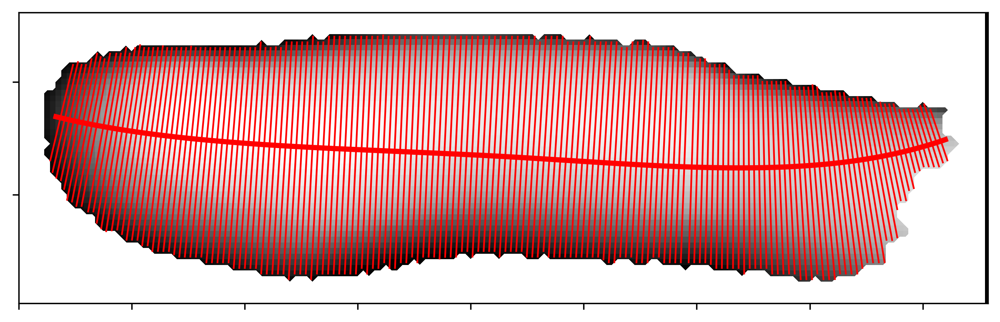

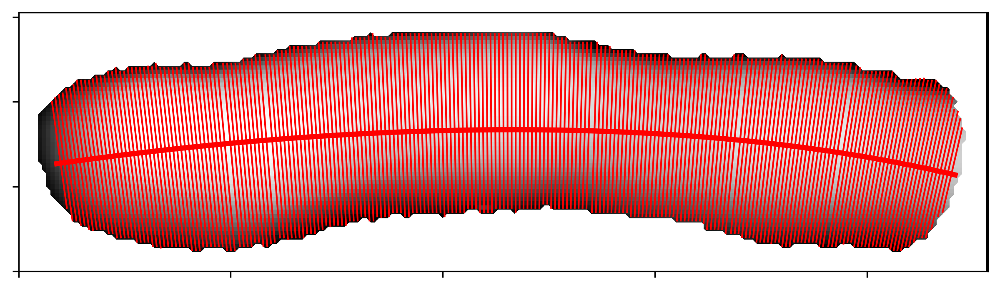

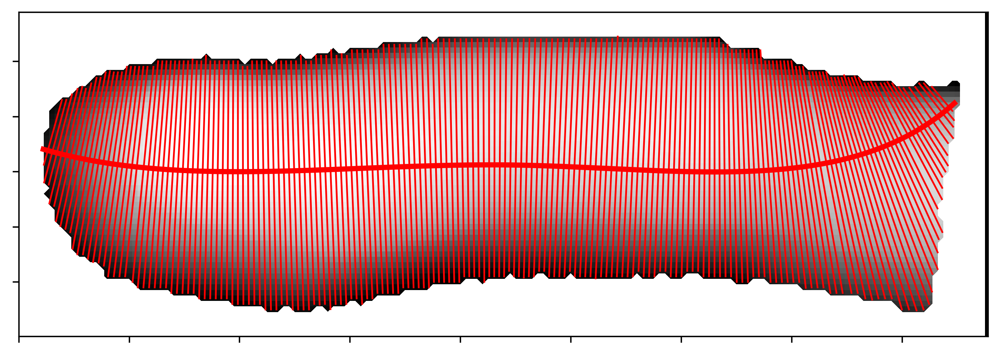

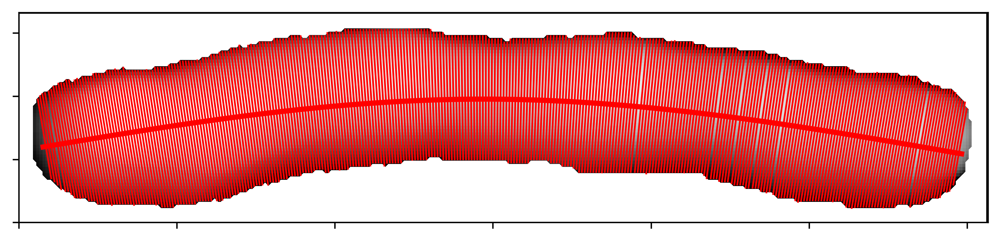

...

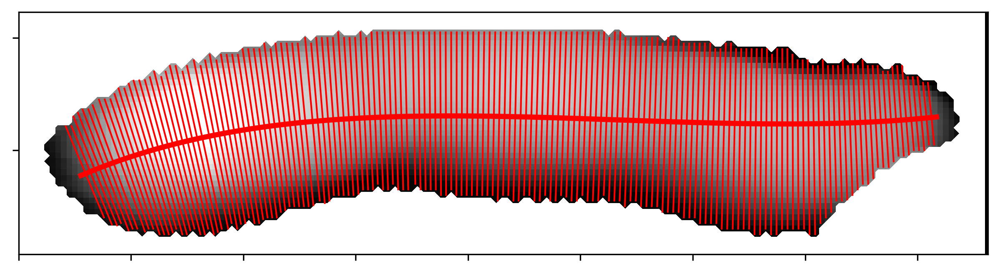

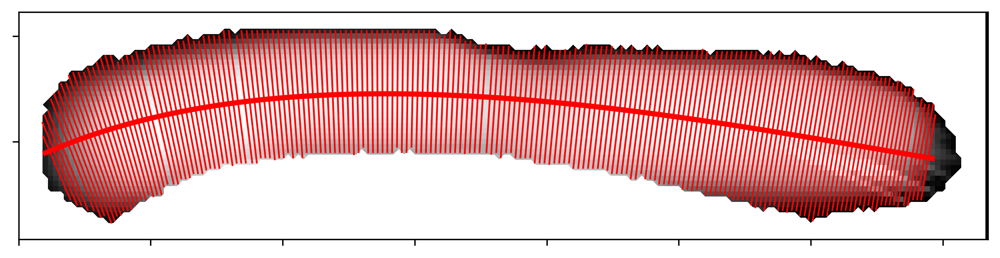

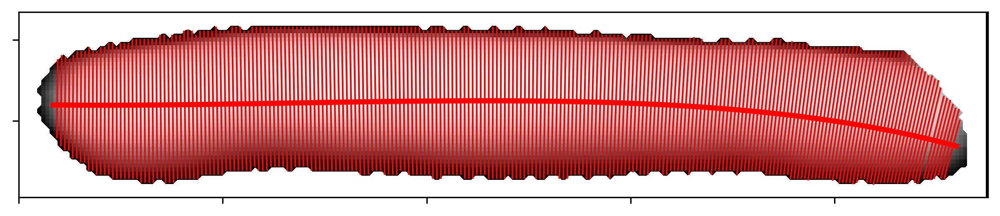

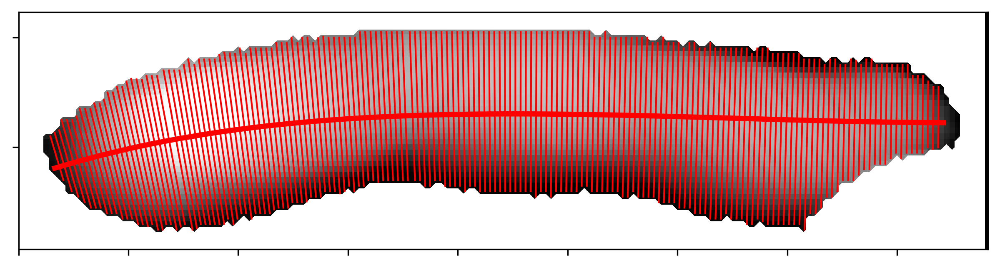

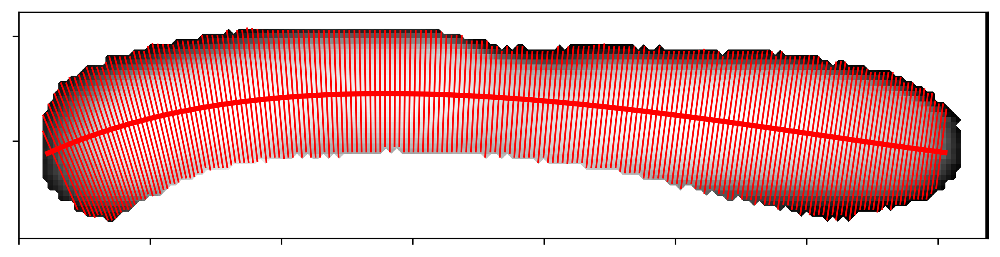

In [24]:
# For each image file we are analyzing, we are going to use RadFil to create a RadFil object and then extract the distance
# And pixel intensity profiles from each cell. 
metadata_dict["Intensity Profile"], metadata_dict["Ridgeline"], metadata_dict["Distance Profile"], metadata_dict["Width"] = tools.apply_radfil(ind_cell_dict["Height"],
                                                                                                                                         ind_cell_dict["Mask"], 
                                                                                                                                         ind_cell_dict["Skeleton"],
                                                                                                                                        conv = 3.9215686274509802)

In [103]:
average_diam_list = []
stdev_diam_list = []
mask_dict = dict(zip(structural_dict["Time"], ind_cell_dict['Skel + Mask']))
width_dict = dict(zip(structural_dict["Time"], metadata_dict['Width']))
chonker_dict = {}
chonker_times = []
curvy_dict = {}
curvy_times = []
for time in width_dict:
    average_diam_set = []
    stdev_diam_set = []
    width_set = width_dict[time]
    for width_list in width_set:
        diam = np.average(width_list)
        dev = np.std(width_list)
        average_diam_set.append(diam)
        stdev_diam_set.append(dev)
    average_diam_list = average_diam_list + average_diam_set
    stdev_diam_list = stdev_diam_list + stdev_diam_set
    temp_dict = dict(zip(average_diam_set,mask_dict[time]))
    temp_dict_2 = dict(zip(stdev_diam_set,mask_dict[time]))
    chonker_set = []
    curvy_set = []
    for diam in temp_dict:
        if diam>35:
            chonker_set.append(temp_dict[diam])
            chonker_times.append(time)
    for stdev in temp_dict_2:
        if stdev>9:
            curvy_set.append(temp_dict_2[stdev])
            curvy_times.append(time)
    if len(chonker_set)>0:
        chonker_dict[time] = chonker_set
    if len(curvy_set)>0:
        curvy_dict[time]=curvy_set

In [128]:
chonker_times

[3301940,
 3302013,
 3302022,
 3302032,
 3302040,
 3302137,
 3302137,
 3302146,
 3302146,
 3302155,
 3302155,
 3302213,
 3302221,
 3302230,
 3302239,
 3302248,
 3302248]

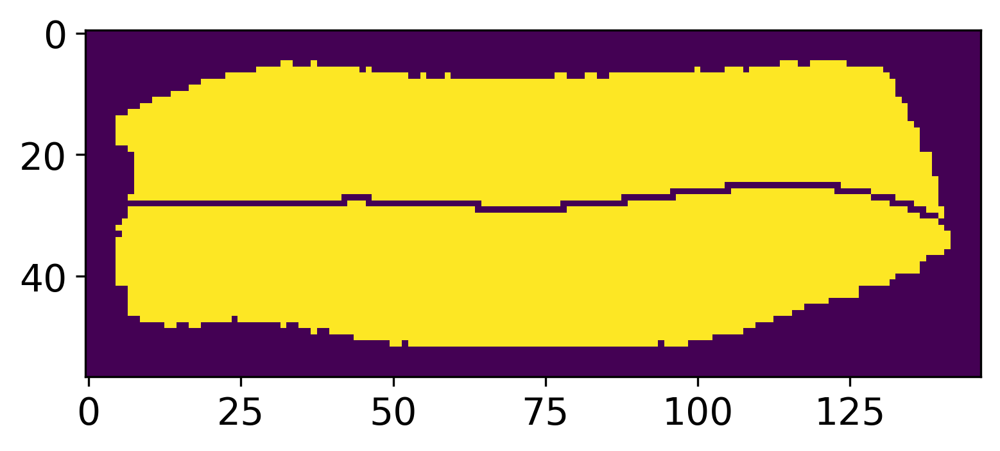

In [159]:
time = chonker_times[15]
plt.imshow(chonker_dict[time][1])

(array([10., 31., 17.,  6.,  9.,  7.,  6.,  1.,  1.,  2.]),
 array([ 2.15001447,  3.15924986,  4.16848524,  5.17772063,  6.18695602,
         7.1961914 ,  8.20542679,  9.21466218, 10.22389757, 11.23313295,
        12.24236834]),
 <BarContainer object of 10 artists>)

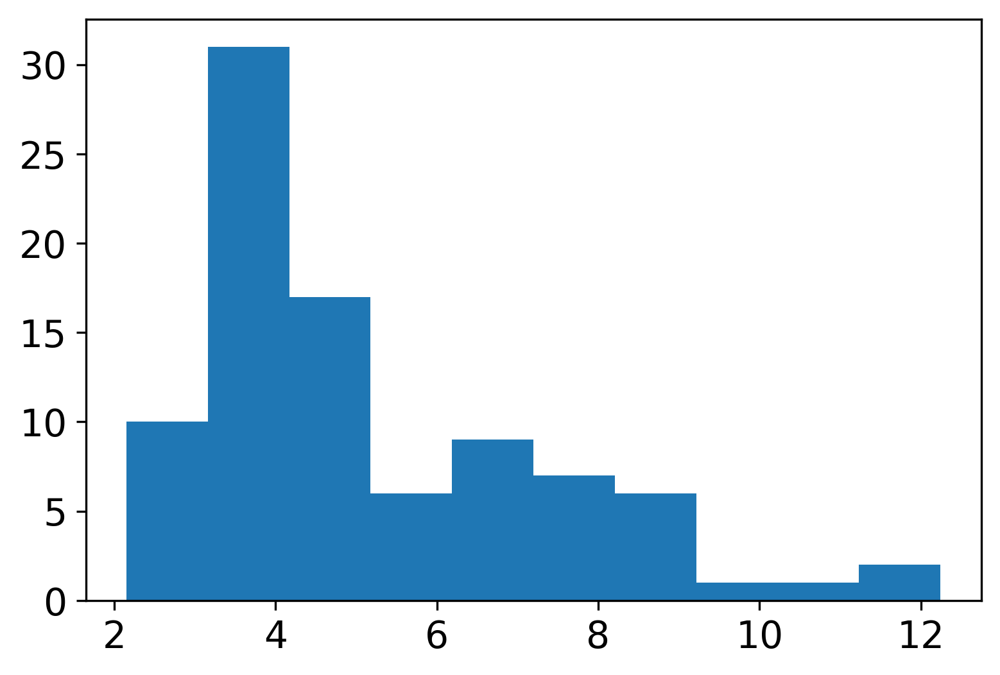

In [102]:
plt.hist(stdev_diam_list)

In [79]:
diam_dict = dict(zip(structural_dict['Time'], average_diam_list))
mask_dict = dict(zip(structural_dict["Time"], ind_cell_dict['Skel + Mask']))

In [80]:
for time in diam_dict:
    if diam_dict[time]>35:
        chonker_dict[time] = list(ind_cell_dict['Skel + Mask'])